In [1]:
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import display, Latex

import glob
from astropy.io import fits

%matplotlib inline
%config InlineBackend.figure_format='retina'
#!pip install git+https://github.com/M-Bianchi/My_matplotlib_style
plt.style.use('mystyle')

g:  3x120s\
r:  3x120s\
i:  3x180s\
Ha: 1x900s + 4x300s

In [2]:
path_20241028 = "Data/20241028/"
filenames_20241028 = glob.glob(path_20241028 + '*fit')

In [3]:
path_20241029 = "Data/20241029/"
filenames_20241029 = glob.glob(path_20241029 + '*fit')

# Bias frame

The bias is a frame with the telescope dome closed and zero exposure time.\
The result is not of zero counts, as one may expect, due to the fact that we are applying a baseline voltage to each pixel in order to be in the linear regime.\
It should be a constant baseline of counts (with an uncertainty given by the readout noise) that can be subtracted from the scientific image.\
We consider the average of multiple bias frames to reduce the uncertainty on the bias (thanks to Central Limit Theorem), which obviously is not removable by just subtracting the bias.

In [4]:
def get_bias(filenames, string):
    allbias = []

    for i, filename in enumerate (filenames):
        if(string in filenames[i]):
            mybias = fits.open(filename)
            allbias.append(mybias[0].data)
            mybias.close(filename)

    allbias = np.array(allbias)
    print('Number of biases =', allbias.shape[0])

    return np.mean(allbias, axis=0)

Number of biases = 10


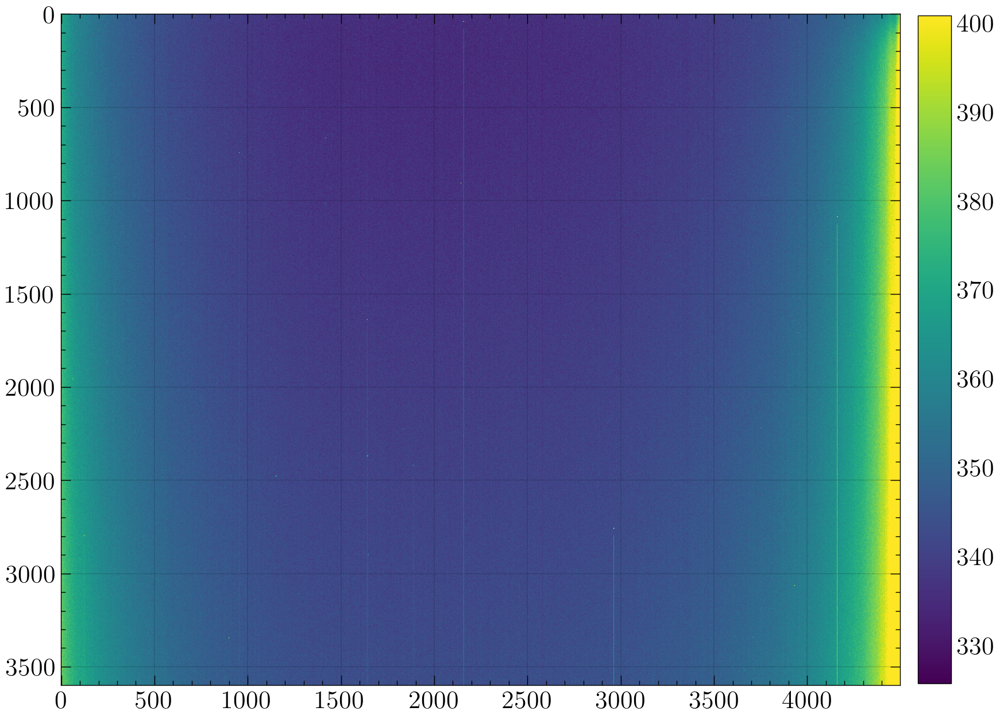

In [5]:
meanbias_20241028 = get_bias(filenames_20241028, 'bias')

plt.imshow(meanbias_20241028, clim=np.quantile(meanbias_20241028, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

Number of biases = 10


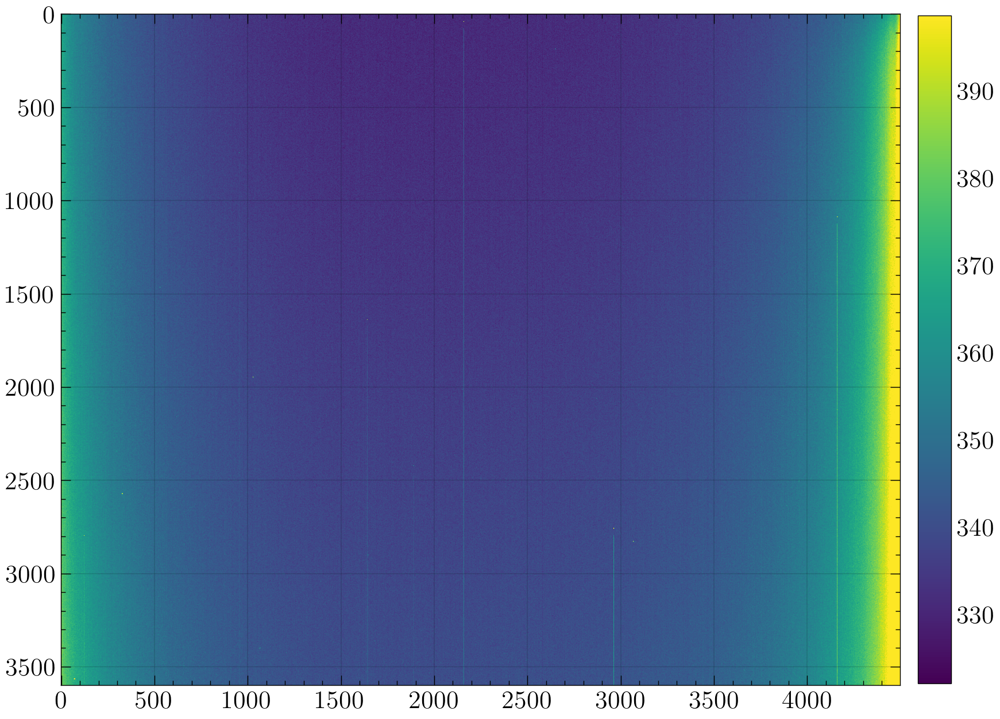

In [6]:
meanbias_20241029 = get_bias(filenames_20241029, 'Bias')

plt.imshow(meanbias_20241029, clim=np.quantile(meanbias_20241029, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

# Dark frame

We read the detector after some time of no light going in, measuring the dark current counts (+ the bias, of course).\
We can repeat the measure for different exposure times, obtaining a curve of the dark current counts as a function of the exposure time.

def Dark_frame(filenames, darkname):

    alldark = []

    for i, filename in enumerate (filenames):
        if(darkname in filenames[i]):
            mydark = fits.open(filename)
            alldark.append(mydark[0].data)
            mydark.close(filename)

    alldark = np.array(alldark)
    print('Shape of all'+darkname, alldark.shape)

    return np.mean(alldark, axis=0)

    
meandark1 = Dark_frame(filenames, 'dark1.')
meandark10 = Dark_frame(filenames, 'dark10.')
meandark100 = Dark_frame(filenames, 'dark100.')
meandark1000 = Dark_frame(filenames, 'dark1000.')

meandarkplot = meandark1000 - meanbias    
plt.imshow(meandarkplot, clim=np.quantile(meandarkplot, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

dark_texp = np.array([1, 10, 100, 1000])

plt.plot(dark_texp, np.array([np.mean(meandark1), np.mean(meandark10), np.mean(meandark100), np.mean(meandark1000)]), 'o');

# Flat frame

Not all the pixels have the same response. Often the edges of the detector are less responsive. There may also be some dead columns, due to manufacturing faults or accidental damage.\
One way to produce a flat is to observe the sky at sunset, assuming a uniform flux. Another way is to use a lamp (this is what we will do).\
The flat must be normalized such that the average value is one.

In [7]:
def get_flat(filenames, meanbias, meanflat, string):
    for filter in meanflat.keys():
        allflat = []
    
        for i, filename in enumerate (filenames):
            if(string+filter in filenames[i]):
                myflat = fits.open(filename)
                allflat.append(myflat[0].data)
                myflat.close(filename)

        allflat = np.array(allflat)
        print('Number of flats for the '+filter+' filter = ', allflat.shape[0])

        meanflat_temp = np.mean(allflat, axis=0) - meanbias
        meanflat[filter] = (meanflat_temp) / np.mean(meanflat_temp)
        
    return meanflat

Number of flats for the g filter =  5
Number of flats for the r filter =  5
Number of flats for the i filter =  5
Number of flats for the Ha filter =  5


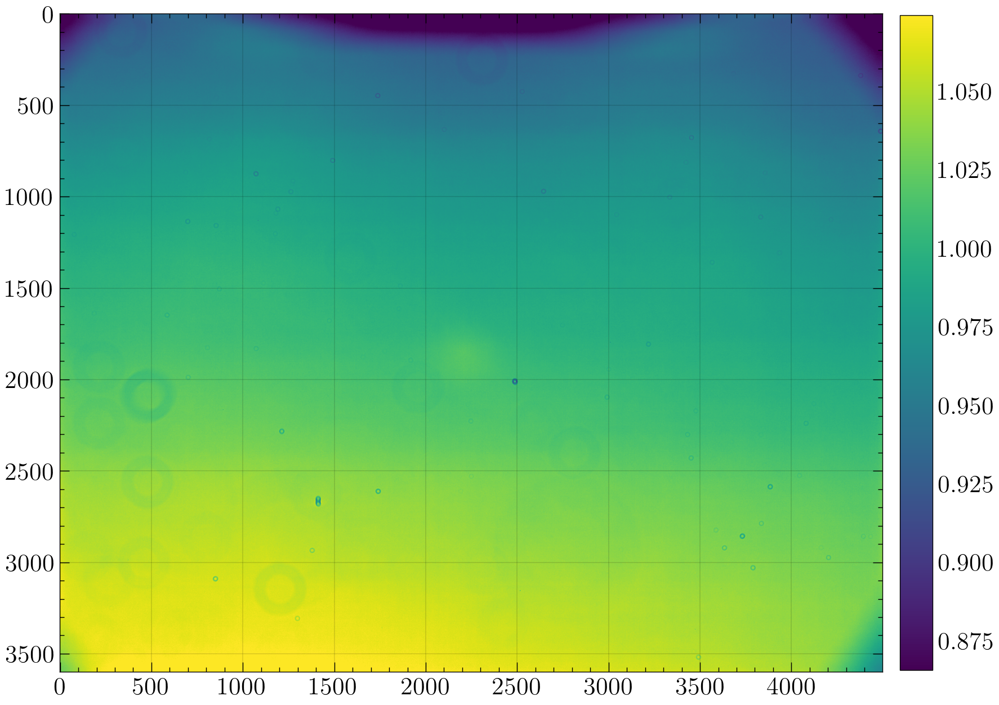

In [8]:
meanflat_20241028 = {'g':np.zeros((3599, 4499)), 
                     'r':np.zeros((3599, 4499)), 
                     'i':np.zeros((3599, 4499)), 
                     'Ha':np.zeros((3599, 4499))}

meanflat_20241028 = get_flat(filenames_20241028, meanbias_20241028, meanflat_20241028, 'flat_m20_')

plt.imshow(meanflat_20241028['g'], clim=np.quantile(meanflat_20241028['g'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

Number of flats for the Ha filter =  5


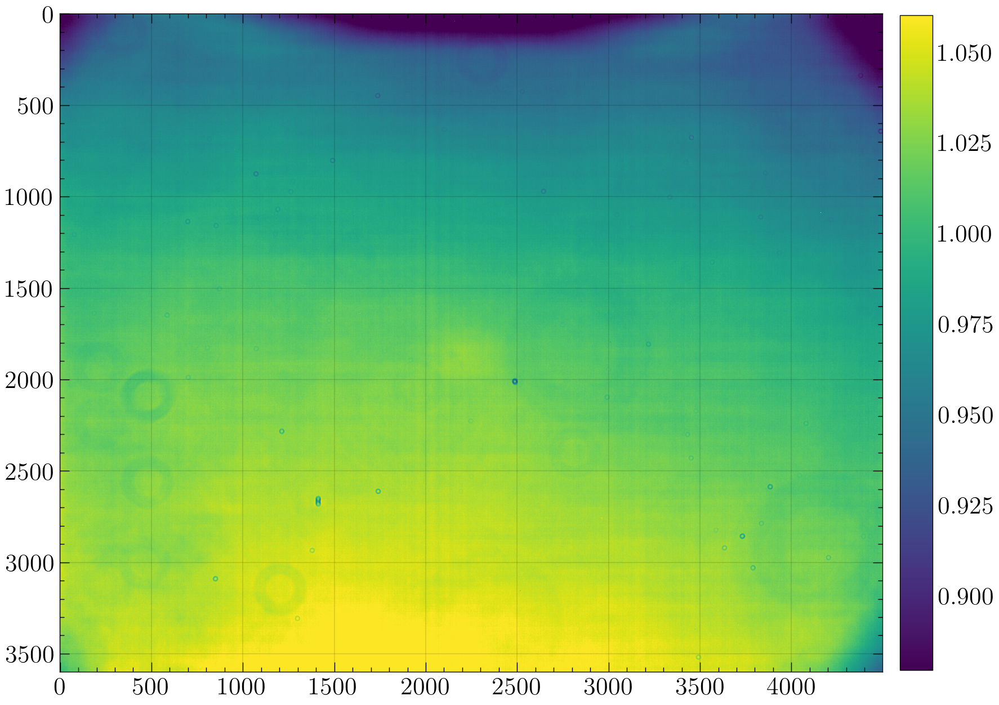

In [9]:
meanflat_20241029 = {'Ha':np.zeros((3599, 4499))}

meanflat_20241029 = get_flat(filenames_20241029, meanbias_20241029, meanflat_20241029, 'flat_')

plt.imshow(meanflat_20241029['Ha'], clim=np.quantile(meanflat_20241028['Ha'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

# Applying corrections

<font color='red'>How could we shift the frames to compensate for dithering?</font>

In [10]:
def get_science_image(filenames, meanbias, meanflat, science_image, string):
    for filter in meanflat.keys():
        allimage = []

        for i, filename in enumerate (filenames):
            if(string+filter in filenames[i]):
                myimage = fits.open(filename)
                myimage_corrected = (myimage[0].data - meanbias) / meanflat[filter]
                allimage.append(myimage_corrected)
                myimage.close(filename)

        allimage = np.array(allimage)
        print('Number of images for the '+filter+' filter = ', allimage.shape[0])

        science_image[filter] = np.sum(allimage, axis=0)
        
    return science_image

In [11]:
science_image_20241028 = {'g':np.zeros((3599, 4499)), 
                          'r':np.zeros((3599, 4499)), 
                          'i':np.zeros((3599, 4499)), 
                          'Ha':np.zeros((3599, 4499))}

science_image_20241028 = get_science_image(filenames_20241028, meanbias_20241028, meanflat_20241028, science_image_20241028, 'IC5146_')

Number of images for the g filter =  3
Number of images for the r filter =  3
Number of images for the i filter =  3
Number of images for the Ha filter =  1


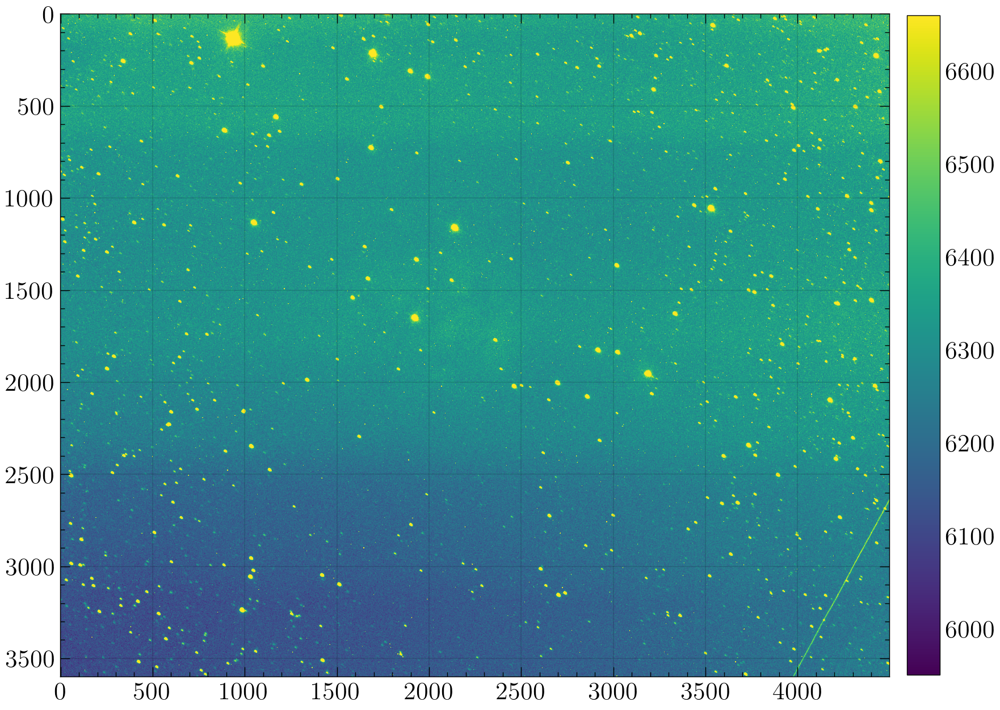

In [12]:
plt.imshow(science_image_20241028['g'], clim=np.quantile(science_image_20241028['g'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

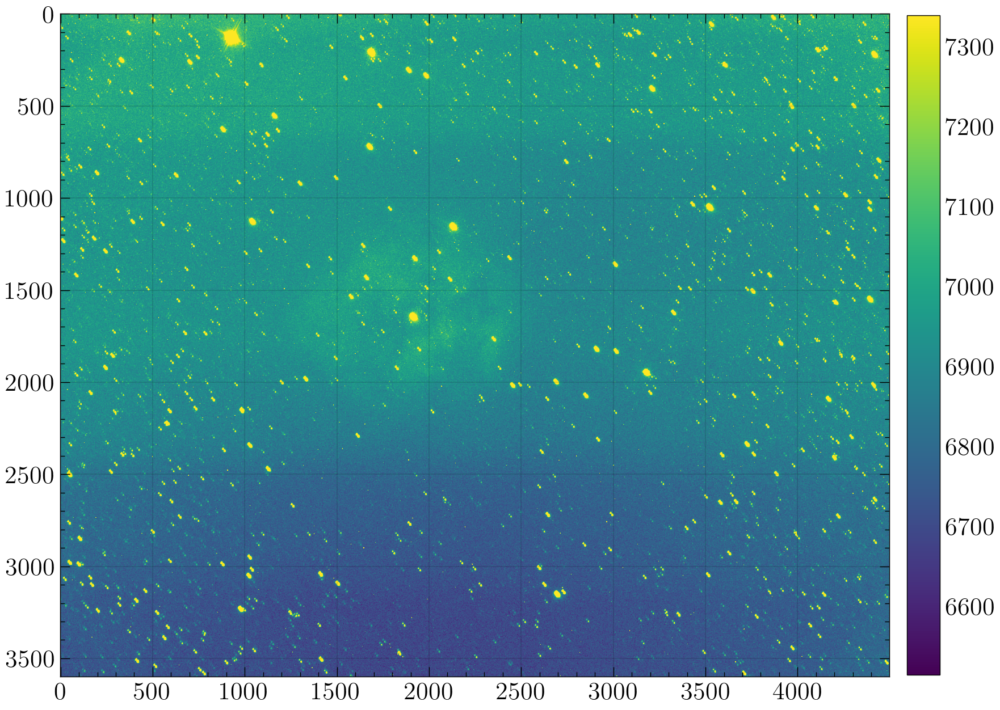

In [13]:
plt.imshow(science_image_20241028['r'], clim=np.quantile(science_image_20241028['r'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

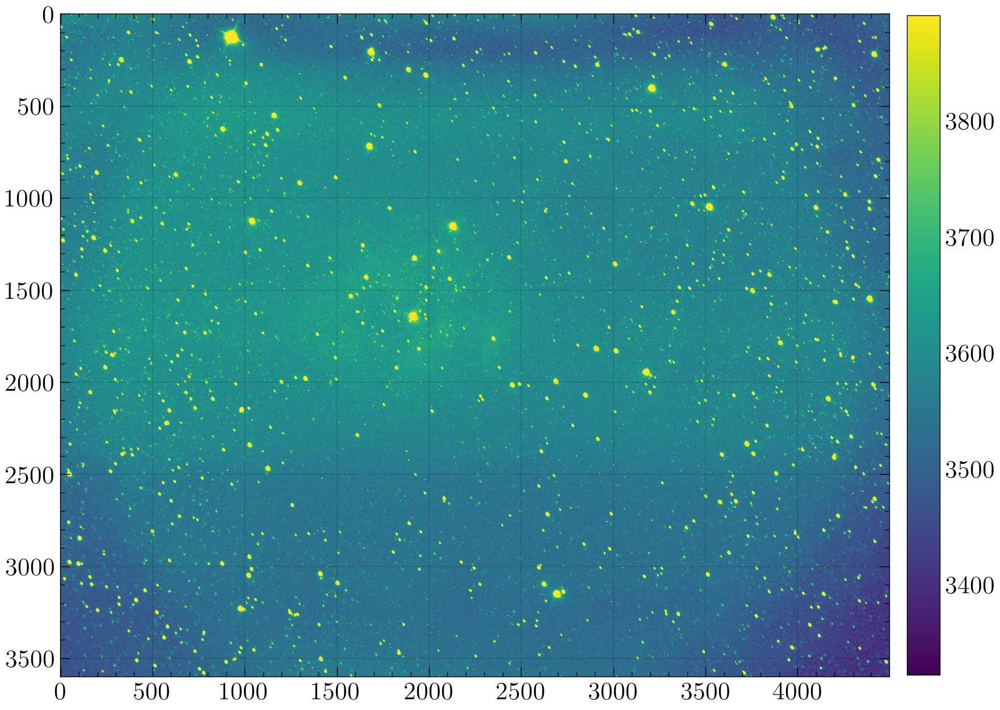

In [14]:
plt.imshow(science_image_20241028['i'], clim=np.quantile(science_image_20241028['i'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

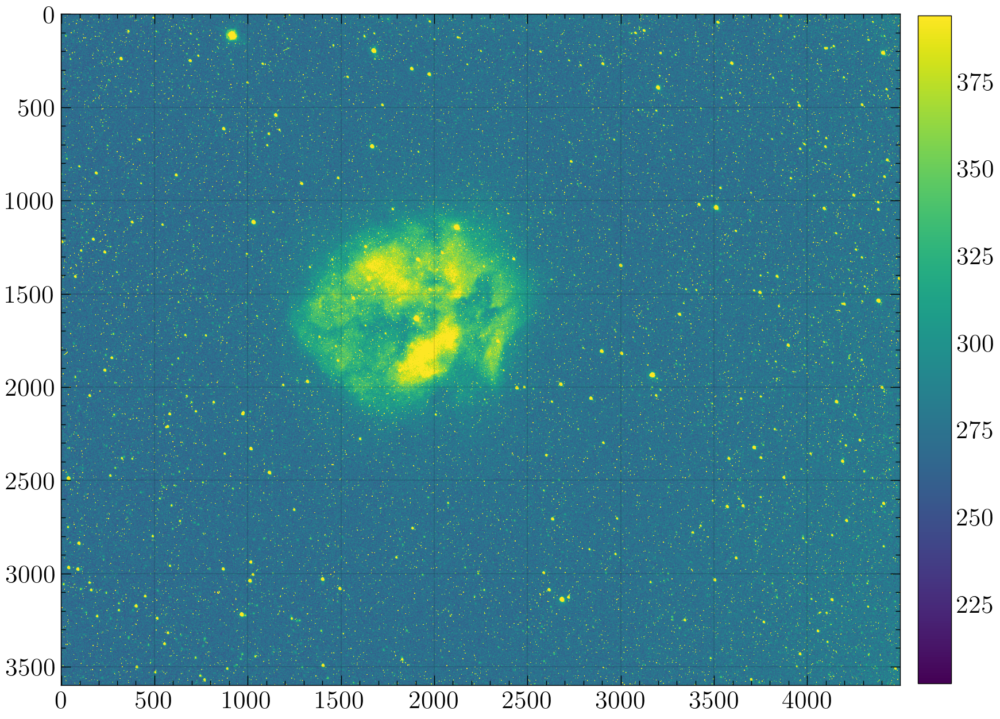

In [15]:
plt.imshow(science_image_20241028['Ha'], clim=np.quantile(science_image_20241028['Ha'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

Number of images for the Ha filter =  4


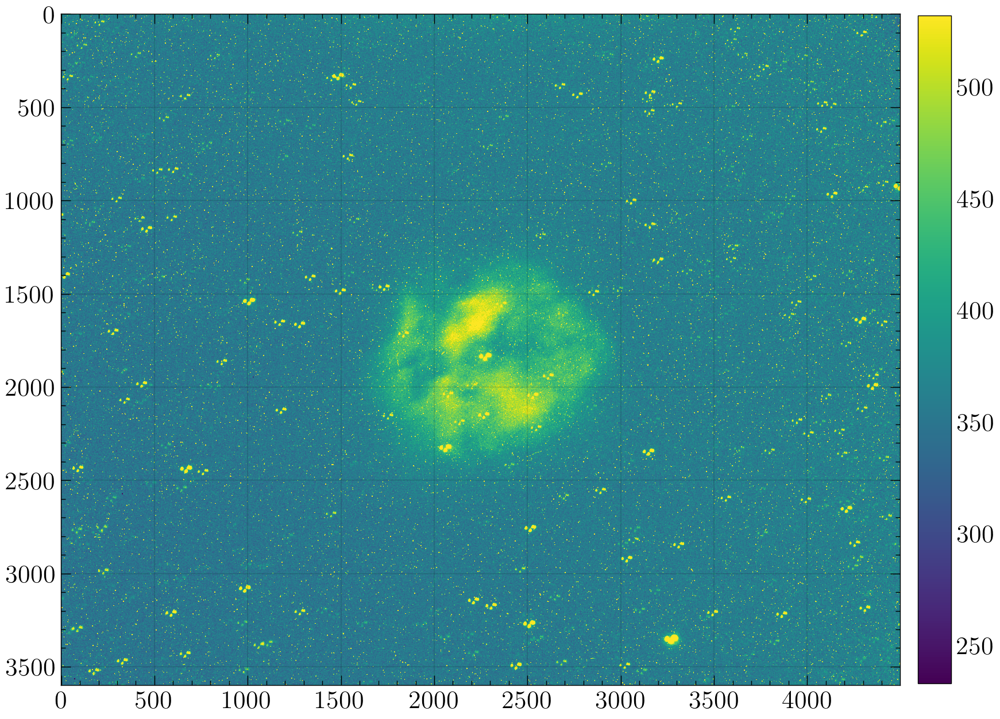

In [18]:
science_image_20241029 = {'Ha':np.zeros((3599, 4499))}

science_image_20241029 = get_science_image(filenames_20241029, meanbias_20241029, meanflat_20241029, science_image_20241029, 'IC5146_')

plt.imshow(science_image_20241029['Ha'], clim=np.quantile(science_image_20241029['Ha'], [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

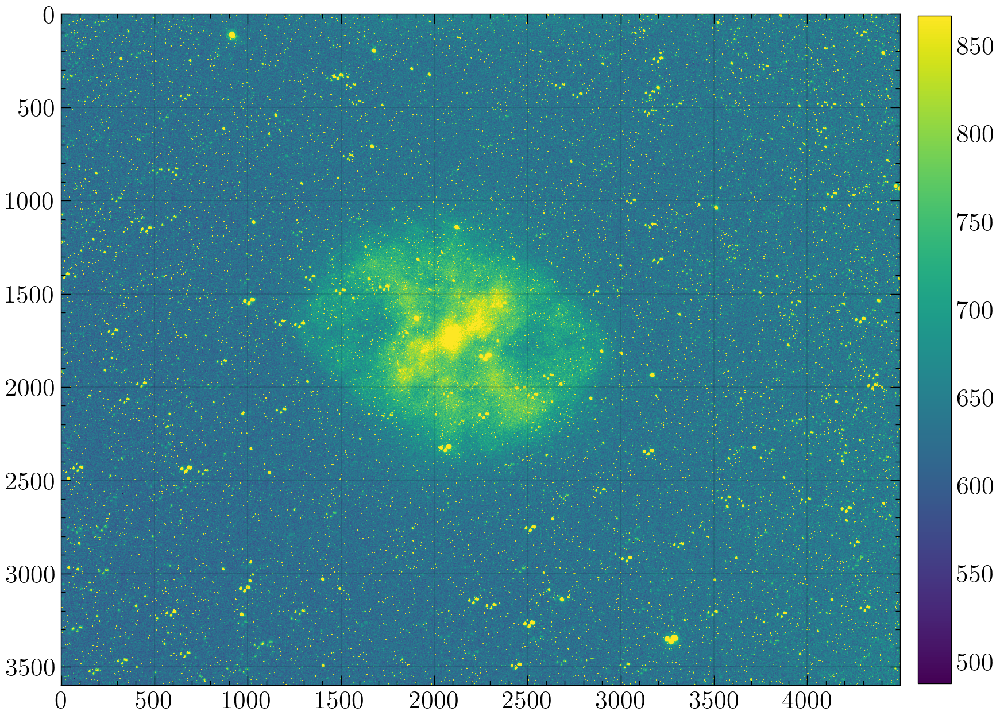

In [19]:
science_image_Ha = science_image_20241028['Ha'] + science_image_20241029['Ha']

plt.imshow(science_image_Ha, clim=np.quantile(science_image_Ha, [0.01, 0.99]))
plt.colorbar(fraction=0.0375, pad=0.02);

x_plot = np.arange(0, science_image.shape[0])
y_plot = np.sum(science_image, axis=1)
plt.plot(x_plot, y_plot);

x_plot = np.arange(0, science_image.shape[1])
y_plot = np.sum(science_image, axis=0)
plt.plot(x_plot, y_plot);